### author by yangshichen
### 注意：脚本仅供参考，使用前请仔细阅读

### 加载包

In [1]:
import os
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import seaborn as sb
import seaborn as sns
from matplotlib.pyplot import rc_context
import matplotlib.pyplot as plt
from scipy.io import mmread
from scipy.sparse import csr_matrix
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42

import warnings
warnings.filterwarnings("ignore")

In [ ]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, frameon=False)
sc._settings.ScanpyConfig.n_jobs=70

In [2]:
cluster_cols = ["#DC050C", "#FB8072", "#1965B0", "#7BAFDE", "#882E72", 
                "#B17BA6", "#FF7F00", "#FDB462", "#E7298A", "#E78AC3", 
                "#33A02C", "#B2DF8A", "#55A1B1", "#8DD3C7", "#A6761D", 
                "#E6AB02", "#7570B3", "#BEAED4", "#666666", "#999999", 
                "#aa8282", "#d4b7b7", "#8600bf", "#ba5ce3", "#808000", 
                "#aeae5c", "#1e90ff", "#00bfff", "#56ff0d", "#ffff00"]

### 读取矩阵创建h5ad文件

In [9]:
def read_data(path,sample_name,output): 
    file_list=os.listdir(path) # 读取路径
    for file in file_list:
        if file =="barcodes.tsv.gz": # 读取barcodes
            file=os.path.join(path,file)         
            obs = pd.read_csv(file, header=None, index_col=0, sep="\t")
            obs.index.name = "barcode"
        if file =="features.tsv.gz": # 读取features
            file=os.path.join(path,file)                      
            var = pd.read_csv(file, header=None, index_col=0, sep="\t")
            var.index.name='gene_id'
        if file =="matrix.mtx.gz":  # 读取 matrix   
            file=os.path.join(path,file)
            mtx = csr_matrix(mmread(file).T)
    adata=sc.AnnData(mtx,obs=obs,var=var)
    adata.var_names_make_unique()
    #初步过滤
    sc.pp.filter_cells(adata, min_genes=200)
    sc.pp.filter_genes(adata, min_cells=3)
    adata.var['mt'] = adata.var_names.str.startswith('MT-')
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
    adata = adata[adata.obs.n_genes_by_counts > 200, :]
    adata = adata[adata.obs.n_genes_by_counts < 6500, :]
    adata = adata[adata.obs.total_counts > 1000, :]
    adata = adata[adata.obs.total_counts < 25000, :]
    adata = adata[adata.obs.pct_counts_mt < 10, :]
    #去双胞
    scrub = scr.Scrublet(counts_matrix=adata.X,
                         expected_doublet_rate = 0.08*adata.obs.shape[0]/10000)#设置双胞率
    scrub.scrub_doublets(min_counts=2,min_cells=3,log_transform = True,
                     n_prin_comps=30,min_gene_variability_pctl=85)#识别双胞
    scrub.call_doublets(threshold=0.2)
    adata.obs['doublet_score'] = scrub.doublet_scores_obs_
    adata.obs['doublet'] = scrub.predicted_doublets_
    adata.var['features']=adata.var_names.to_list()
    out_file=os.path.join(output,sample_name+'.h5ad')
    adata.write(out_file)
    print(sample_name,"done")

In [11]:
inputpath ='/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/SpliceMatrix/'
output = '/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/h5ad/'
file_list = os.listdir(inputpath)

for i in file_list:
    path = inputpath + i
    sample_name = i
    read_data(path,sample_name,output)

filtered out 235 cells that have less than 200 genes expressed
filtered out 5795 genes that are detected in less than 3 cells
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.32
Detected doublet rate = 5.1%
Estimated detectable doublet fraction = 67.1%
Overall doublet rate:
	Expected   = 10.3%
	Estimated  = 7.6%
Elapsed time: 23.7 seconds
Detected doublet rate = 9.1%
Estimated detectable doublet fraction = 81.5%
Overall doublet rate:
	Expected   = 10.3%
	Estimated  = 11.2%
PD-H270-1 done
filtered out 984 cells that have less than 200 genes expressed
filtered out 5932 genes that are detected in less than 3 cells
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.34
Detected doublet rate = 2.3%
Estimated detectable doublet fraction = 56.1%
Overall doublet rate:
	Expected   = 7.

### h5ad文件合并

In [8]:
# 获取文件夹下所有h5ad文件
files = os.listdir('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/h5ad/')
files = [f for f in files if f.endswith('.h5ad')]
adata_list=[]
sample_list=[]
for i in files:
    path=os.path.join('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/h5ad/',i)
    adata=sc.read(path)
    sample=i[:-5]
    adata_list.append(adata)
    sample_list.append(sample)

In [9]:
adatas=sc.concat(adata_list,label='batch',keys=sample_list,join='outer')
adatas

AnnData object with n_obs × n_vars = 3227755 × 36086
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch'

In [10]:
adatas.obs['doublet'].value_counts()

False    2994418
True      233337
Name: doublet, dtype: int64

### 数据分组

In [12]:
#sample
adatas.obs["sample"] = adatas.obs["batch"]
# 修改特殊文库
adatas.obs["sample"].replace({'HD-H280-1-1': 'HD-H280-5'}, inplace=True)
adatas.obs["sample"].replace({'HD-H280-1-2': 'HD-H280-5'}, inplace=True)
adatas.obs["sample"].replace({'HD-H280-2-1': 'HD-H280-6'}, inplace=True)
adatas.obs["sample"].replace({'HD-H280-2-2': 'HD-H280-6'}, inplace=True)
# 去掉adatas.obs["sample"]中的所有-1/-2
adatas.obs["sample"] = adatas.obs["sample"].str.replace("-1", "")
adatas.obs["sample"] = adatas.obs["sample"].str.replace("-2", "")
adatas.obs["sample"] = adatas.obs["sample"].str.replace("-3", "")
adatas.obs["sample"] = adatas.obs["sample"].str.replace("-4", "")
# 修改特殊文库
adatas.obs["sample"].replace({'HD-H280-5': 'HD-H280-1'}, inplace=True)
adatas.obs["sample"].replace({'HD-H280-6': 'HD-H280-2'}, inplace=True)

In [13]:
adatas.obs["sample"].value_counts()

HD-H333    53930
HD-H134    52167
HD-H135    51653
HD-H322    40631
HD-H317    35546
           ...  
HD-H313     9442
PD-H224     9197
PD-H307     8689
PD-H218     7889
PD-H227     7707
Name: sample, Length: 143, dtype: int64

In [14]:
#stage
adatas.obs["stage"] = adatas.obs["sample"]
adatas.obs["stage"] = adatas.obs["stage"].replace(['HD-H134','HD-H135','HD-H136','HD-H137','HD-H138','HD-H140','HD-H141','HD-H143',
                                                   'HD-H145','HD-H146','HD-H147','HD-H148','HD-H150','HD-H153','HD-H154','HD-H155',
                                                   'HD-H156','HD-H157','HD-H160','HD-H161','HD-H162','HD-H273','HD-H274','HD-H275',
                                                   'HD-H276','HD-H277','HD-H279','HD-H280-1','HD-H280-2','HD-H309','HD-H311','HD-H312',
                                                   'HD-H313','HD-H314','HD-H315','HD-H316','HD-H317','HD-H318','HD-H319','HD-H320',
                                                   'HD-H321','HD-H322','HD-H323','HD-H324','HD-H325','HD-H326','HD-H327','HD-H329',
                                                   'HD-H330','HD-H332','HD-H333','HD-H334','HD-H388'], 'HDs')
adatas.obs["stage"] = adatas.obs["stage"].replace(['PD-H203','PD-H206','PD-H208','PD-H209','PD-H211','PD-H213','PD-H216','PD-H226',
                                                   'PD-H227','PD-H234','PD-H235','PD-H236','PD-H239','PD-H243','PD-H245','PD-H248',
                                                   'PD-H249','PD-H250','PD-H251','PD-H252','PD-H253','PD-H262','PD-H267','PD-H268',
                                                   'PD-H269','PD-H270','PD-H271','PD-H272','PD-H273','PD-H275','PD-H279','PD-H282',
                                                   'PD-H284','PD-H287','PD-H292','PD-H293','PD-H295','PD-H296','PD-H297','PD-H299',
                                                   'PD-H300','PD-H301','PD-H302','PD-H305','PD-H306','PD-H307','PD-H308'], 'IRs')
adatas.obs["stage"] = adatas.obs["stage"].replace(['PD-H201','PD-H202','PD-H204','PD-H207','PD-H210','PD-H212','PD-H214','PD-H218',
                                                   'PD-H219','PD-H220','PD-H221','PD-H222','PD-H223','PD-H224','PD-H225','PD-H228',
                                                   'PD-H229','PD-H230','PD-H231','PD-H232','PD-H233','PD-H237','PD-H238','PD-H240',
                                                   'PD-H241','PD-H242','PD-H246','PD-H247','PD-H255','PD-H258','PD-H260','PD-H263',
                                                   'PD-H264','PD-H265','PD-H266','PD-H276','PD-H277','PD-H278','PD-H281','PD-H285',
                                                   'PD-H286','PD-H288','PD-H289'], 'INRs')

In [15]:
adatas.obs["stage"].value_counts()

HDs     1357144
IRs     1003728
INRs     866883
Name: stage, dtype: int64

In [17]:
#experiments
adatas.obs["experiments"] = adatas.obs["sample"]
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['HD-H136','HD-H137','HD-H138'], 'batch1')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['HD-H140','HD-H141','HD-H143','HD-H145','HD-H146','HD-H147','HD-H148','HD-H150','HD-H280-2'], 'batch2')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['HD-H153','HD-H154','HD-H155','HD-H156','HD-H157','HD-H160','HD-H161','HD-H162','HD-H311','HD-H312','HD-H315','HD-H316','HD-H317','HD-H319'], 'batch3')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H201','PD-H202','PD-H203','PD-H204','PD-H206','PD-H207','PD-H208'], 'batch4')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H209','PD-H210','PD-H211','PD-H212','PD-H213','PD-H214','PD-H216','PD-H218'], 'batch5')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H219','PD-H220','PD-H221','PD-H222','PD-H223','PD-H224','PD-H225','PD-H226'], 'batch6')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['HD-H320','HD-H321','HD-H314','HD-H322','HD-H323','HD-H324','HD-H325','HD-H326','HD-H329','HD-H330','HD-H332'], 'batch7')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H227','PD-H228','PD-H229','PD-H230','PD-H231','PD-H232','PD-H233','PD-H234'], 'batch8')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H235','PD-H236','PD-H237','PD-H238','PD-H239','PD-H240','PD-H241','PD-H242'], 'batch9')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H243','PD-H245','PD-H246','PD-H247','PD-H248','PD-H249','PD-H250','PD-H251'], 'batch10')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H252','PD-H253','PD-H255','PD-H258','PD-H260','PD-H262','PD-H263'], 'batch11')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H264','PD-H265','PD-H266','PD-H267','PD-H268','PD-H269','PD-H270','PD-H271'], 'batch12')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H272','PD-H273','PD-H275','PD-H276','PD-H277','PD-H278','PD-H279','PD-H281'], 'batch13')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H282','PD-H284','PD-H285','PD-H286','PD-H287','PD-H288','PD-H289','PD-H292'], 'batch14')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H293','PD-H295','PD-H296','PD-H297','PD-H299','PD-H300'], 'batch15')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['PD-H301','PD-H302','PD-H305','PD-H306','PD-H307','PD-H308'], 'batch16')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['HD-H273','HD-H275','HD-H277','HD-H388','HD-H318','HD-H280-1','HD-H309','HD-H327'], 'batch17')
adatas.obs["experiments"] = adatas.obs["experiments"].replace(['HD-H333','HD-H334','HD-H276','HD-H279','HD-H274','HD-H313','HD-H134','HD-H135'], 'batch18')

In [18]:
adatas.obs["experiments"].value_counts()

batch3     374253
batch7     258740
batch18    246475
batch17    224701
batch10    213253
batch12    203343
batch13    195818
batch2     177134
batch14    173039
batch8     171638
batch5     152477
batch6     151837
batch9     134850
batch11    131824
batch15    125098
batch4     115981
batch16    101453
batch1      75841
Name: experiments, dtype: int64

In [19]:
#age
adatas.obs["age"] = adatas.obs["sample"]
adatas.obs["age"] = adatas.obs["age"].replace(['PD-H243','HD-H135','PD-H227','PD-H248','PD-H268','PD-H228','PD-H249',
                                               'HD-H136','HD-H140','PD-H239','HD-H141'],'20_29')
adatas.obs["age"] = adatas.obs["age"].replace(['PD-H270','PD-H263','PD-H306','HD-H137','HD-H154','HD-H138','HD-H311',
                                               'PD-H237','PD-H288','PD-H299','HD-H143','HD-H309','PD-H289','PD-H247',
                                               'PD-H210','PD-H240','PD-H258','PD-H216','PD-H235','PD-H305','PD-H219',
                                               'PD-H281','PD-H206','PD-H279','PD-H302','HD-H276','HD-H277','HD-H280-2',
                                               'HD-H312','PD-H201','PD-H264','PD-H269','PD-H284','HD-H156','HD-H160',
                                               'HD-H388','PD-H265','PD-H285','PD-H209','PD-H234','PD-H250','PD-H262',
                                               'PD-H271','PD-H273','PD-H282','PD-H301','HD-H145','HD-H313','HD-H314'], 
                                              '30_39')
adatas.obs["age"] = adatas.obs["age"].replace(['PD-H246','HD-H318','PD-H214','PD-H233','PD-H300','HD-H146','HD-H153',
                                               'HD-H279','HD-H316','PD-H231','PD-H211','PD-H252','PD-H297','HD-H147',
                                               'HD-H155','HD-H273','HD-H315','HD-H317','HD-H319','PD-H241','PD-H266',
                                               'PD-H272','HD-H274','HD-H320','PD-H212','PD-H203','HD-H162','HD-H321',
                                               'PD-H230','PD-H232','HD-H157','HD-H275','HD-H323','PD-H275','PD-H295',
                                               'HD-H322'], 
                                              '40_49')
adatas.obs["age"] = adatas.obs["age"].replace(['PD-H260','PD-H308','HD-H324','PD-H208','PD-H296','PD-H278','PD-H226',
                                               'HD-H325','HD-H134','PD-H204','PD-H222','PD-H229','PD-H277','PD-H287',
                                               'HD-H280-1','HD-H330','PD-H236','HD-H326','HD-H327','HD-H329','PD-H286',
                                               'PD-H253','HD-H148','PD-H221'], 
                                              '50_59')
adatas.obs["age"] = adatas.obs["age"].replace(['PD-H220','PD-H293','PD-H307','HD-H150','HD-H332','HD-H333','PD-H207',
                                               'PD-H224','PD-H225','PD-H276','PD-H213','PD-H251','PD-H245','HD-H334',
                                               'PD-H223','PD-H267','PD-H292','HD-H161','PD-H238'], 
                                              '60_69')
adatas.obs["age"] = adatas.obs["age"].replace(['PD-H218','PD-H255','PD-H242','PD-H202'], 
                                              '70_79')

In [20]:
adatas.obs["age"].value_counts()

30_39    1066909
40_49     875597
50_59     541038
60_69     386109
20_29     293156
70_79      64946
Name: age, dtype: int64

In [23]:
adatas.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc/pbmc_raw.h5ad')

In [24]:
del adatas

### 数据质控

In [6]:
adata=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/pbmc_celltype.h5ad")

In [7]:
adata

AnnData object with n_obs × n_vars = 2744009 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'celltype_L1', 'phase_ordered', 'celltype_L3', 'celltype_L1_5', 'celltype_L2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'age_colors', 'celltype_L2_colors', 'experiments_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [6]:
#数据统计
adata.var['hb'] = adata.var_names.str.contains('^HB[^(P)]')
adata.var['rp'] = adata.var_names.str.match(r'^RP[SL]')
adata.var['ncRNA'] = adata.var_names.str.match(r'^[A-Z][A-Z][0-9].*\.[0-9]')
adata.var['LOC'] = adata.var_names.str.match(r'(^LOC|LINC)[1-9]*')
adata.var['erccs'] = adata.var_names.str.match(r'^ERCC-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['rp','hb','ncRNA','LOC','erccs'], percent_top=None, log1p = False, inplace=True)

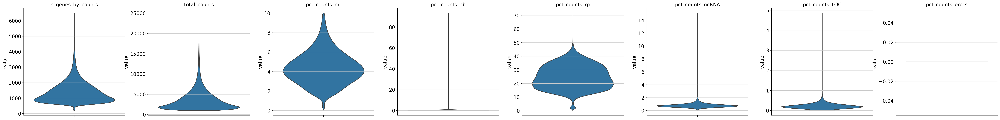

In [7]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_hb','pct_counts_rp','pct_counts_ncRNA','pct_counts_LOC','pct_counts_erccs'],
             jitter=0.4, multi_panel=True,size=0)

In [8]:
#双胞过滤
original_num_cells = adata.n_obs
adata = adata[adata.obs['doublet'] == False, :]
num_filtered_cells = adata.n_obs
num_cells_difference = original_num_cells - num_filtered_cells
print(f"Doublets Filtered out {num_cells_difference} cells. Original number of cells: {original_num_cells}, after filtering: {num_filtered_cells}")

Doublets Filtered out 233337 cells. Original number of cells: 3227755, after filtering: 2994418


In [9]:
#核糖体过滤
original_num_cells = adata.n_obs
adata = adata[adata.obs['pct_counts_rp'] > 5, :]
num_filtered_cells = adata.n_obs
num_cells_difference = original_num_cells - num_filtered_cells
print(f"RP Filtered out {num_cells_difference} cells. Original number of cells: {original_num_cells}, after filtering: {num_filtered_cells}")

RP Filtered out 23184 cells. Original number of cells: 2994418, after filtering: 2971234


In [10]:
#红细胞过滤
original_num_cells = adata.n_obs
adata = adata[adata.obs['pct_counts_hb'] < 1, :]
num_filtered_cells = adata.n_obs
num_cells_difference = original_num_cells - num_filtered_cells
print(f"HB Filtered out {num_cells_difference} cells. Original number of cells: {original_num_cells}, after filtering: {num_filtered_cells}")

HB Filtered out 33268 cells. Original number of cells: 2971234, after filtering: 2937966


In [11]:
#基因过滤
original_num_cells = adata.n_obs
adata = adata[adata.obs.n_genes_by_counts > 500, :]
adata = adata[adata.obs.n_genes_by_counts < 3000, :]
adata = adata[adata.obs.total_counts > 1000, :]
adata = adata[adata.obs.total_counts < 10000, :]
num_filtered_cells = adata.n_obs
num_cells_difference = original_num_cells - num_filtered_cells
print(f"Filtered out {num_cells_difference} cells. Original number of cells: {original_num_cells}, after filtering: {num_filtered_cells}")

Filtered out 57448 cells. Original number of cells: 2937966, after filtering: 2880518


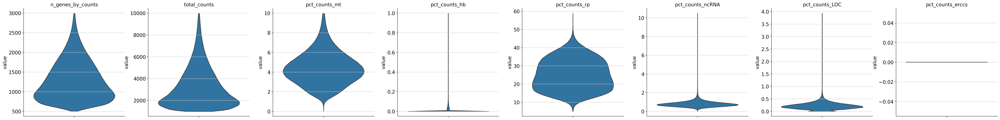

In [12]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_hb','pct_counts_rp','pct_counts_ncRNA','pct_counts_LOC','pct_counts_erccs'],
             jitter=0.4, multi_panel=True,size=0)

In [22]:
stage_order = ['HDs', 'IRs', 'INRs']
adata.obs['stage'] = pd.Categorical(adata.obs['stage'], categories=stage_order, ordered=True)

In [25]:
genes = ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_hb']
stage = adata.obs['stage']
data = adata.obs[genes]
data['stage'] = stage

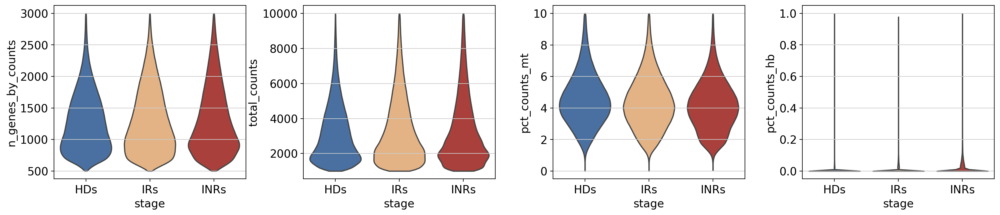

In [15]:
with plt.rc_context({'figure.figsize': (4.5, 4)}):
    sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_hb'],size=0, groupby='stage',palette=color_palette,save = 'qc_stage.pdf')

In [22]:
#过滤基因
mt_genes = list(adata.var_names[adata.var_names.str.match(r'^MT-')]) # 线粒体DNA
hb_genes = list(adata.var_names[adata.var_names.str.contains('^HB[^(P)]')]) 
rb_genes = list(adata.var_names[adata.var_names.str.match(r'^RP[SL]')]) 
ncRNA_genes = list(adata.var_names[adata.var_names.str.match(r'^[A-Z][A-Z][0-9].*\.[0-9]')])
LOC_genes = list(adata.var_names[adata.var_names.str.match(r'(^LOC|LINC)[1-9]*')])
erccs_genes = list(adata.var_names[adata.var_names.str.match(r'^ERCC-')])
remove_genes = mt_genes + hb_genes + rb_genes + ncRNA_genes + LOC_genes + erccs_genes
len(remove_genes)

14407

In [23]:
adata = adata[:,~adata.var_names.isin(remove_genes)]

In [26]:
adata

View of AnnData object with n_obs × n_vars = 2880518 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'sample_colors', 'stage_colors'
    layers: 'counts'

In [22]:
print(adata.layers["counts"].shape)

(2744009, 21679)


In [27]:
adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc/pbmc_filter.h5ad')

### 分群聚类

In [4]:
adata = sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc/pbmc_filter.h5ad")

In [5]:
adata

AnnData object with n_obs × n_vars = 2880518 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'sample_colors', 'stage_colors'
    layers: 'counts'

In [6]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000, flavor="seurat_v3", batch_key="sample")

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [7]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata

normalizing counts per cell
    finished (0:06:15)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:02:54)


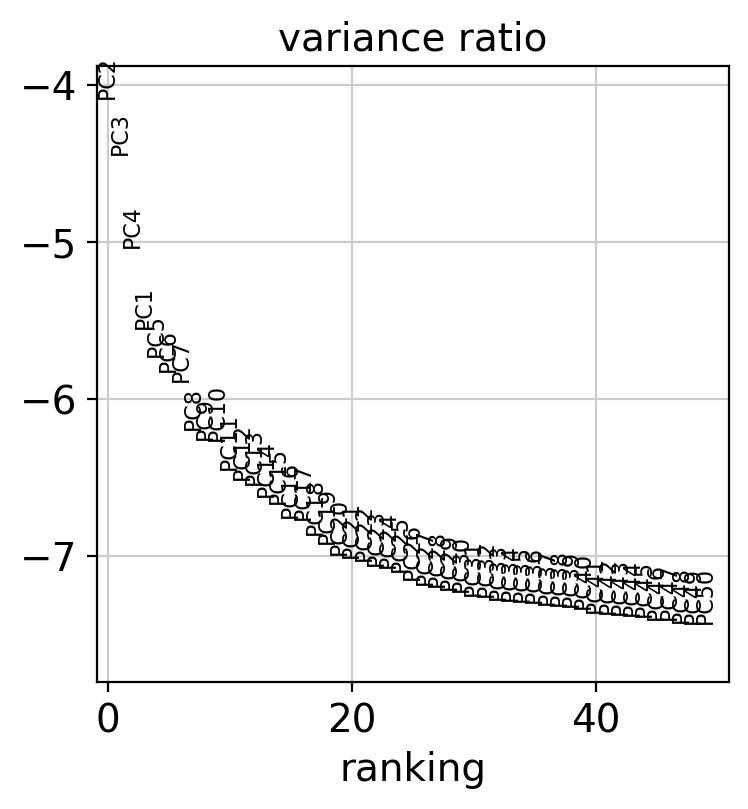

In [8]:
sc.pp.scale(adata, zero_center = False)
sc.tl.pca(adata, zero_center = False, svd_solver='arpack', use_highly_variable=True)
sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)

In [9]:
rsc.pp.harmony_integrate(adata, key = 'batch', max_iter_harmony = 30)

2024-05-06 16:34:35,313 - harmonypy_gpu - INFO - Iteration 1 of 30
2024-05-06 16:49:30,098 - harmonypy_gpu - INFO - Iteration 2 of 30
2024-05-06 17:04:25,381 - harmonypy_gpu - INFO - Iteration 3 of 30
2024-05-06 17:18:47,180 - harmonypy_gpu - INFO - Iteration 4 of 30
2024-05-06 17:30:41,418 - harmonypy_gpu - INFO - Iteration 5 of 30
2024-05-06 17:42:23,403 - harmonypy_gpu - INFO - Converged after 5 iterations


In [10]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=26, use_rep='X_pca_harmony')
sc.tl.umap(adata, min_dist = 0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:13:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (1:39:34)


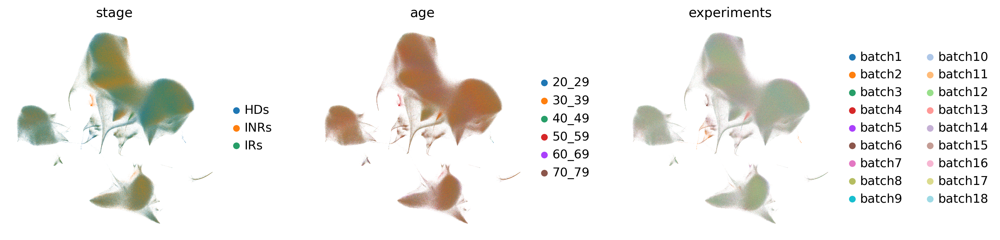

In [11]:
sc.pl.umap(adata, color=['stage', 'age', 'experiments'], wspace=0.3)

running Leiden clustering
    finished: found 53 clusters and added
    'leiden_r2.0_n2', the cluster labels (adata.obs, categorical) (0:26:59)


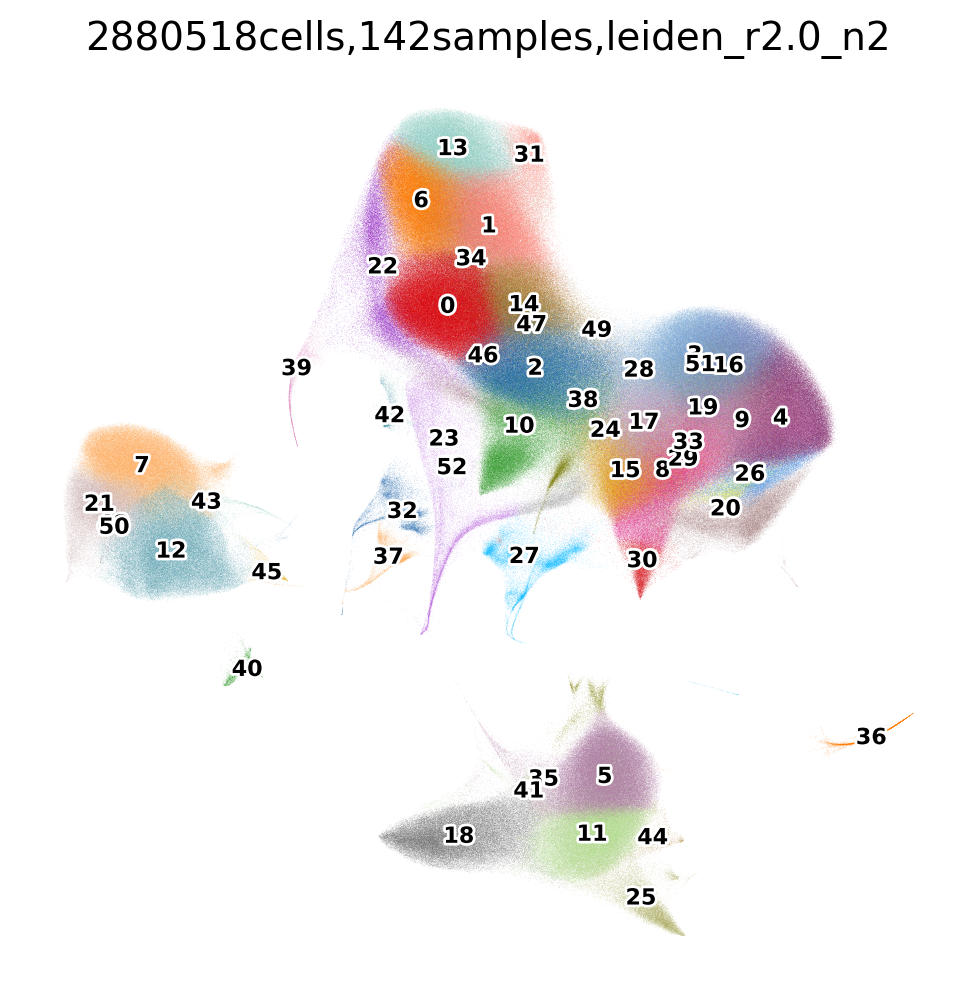

In [13]:
sc.tl.leiden(adata,resolution=2.0,n_iterations=2,key_added='leiden_r2.0_n2')
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata,color=['leiden_r2.0_n2'],legend_fontsize=8,legend_fontoutline=2,
               palette=cluster_cols,legend_loc="on data",title='2880518cells,142samples,leiden_r2.0_n2',save='_all_leiden_r2.0_n2.pdf')

In [16]:
adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/pbmc_cluster_raw.h5ad')

### 初步注释

In [5]:
adata = sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/pbmc_cluster_raw.h5ad")
adata

AnnData object with n_obs × n_vars = 2880518 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'log1p', 'neighbors', 'pca', 'sample_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [18]:
new_cluster_names = ['CD8 T','CD8 T','CD8 T','CD8 T','CD8 T','Myeloid','CD8 T','B','CD4 T','CD8 T','CD8 T',
                     'Myeloid','B','NK','CD8 T','CD4 T','CD4 T','CD4 T','Myeloid','CD8 T','CD8 T','B','CD8 T',
                     'CD8 T','CD8 T','Myeloid','CD8 T','CD8 T','CD8 T','CD8 T','CD4 T','NK','CD8 T','CD8 T','CD8 T',
                     'Myeloid','Myeloid','CD8 T','CD8 T','CD8 T','B','Myeloid','CD8 T','B','Myeloid','B','CD8 T','CD8 T',
                     'B','CD8 T','B','CD8 T','CD8 T']
new_cluster_names={str(i):j for i,j in zip(range(53),new_cluster_names)}

In [19]:
adata.obs['leiden_r2.0_n2']=adata.obs['leiden_r2.0_n2'].astype(str)
for k,v in new_cluster_names.items():
    adata.obs.loc[adata.obs['leiden_r2.0_n2']==k,'celltype_L1']= v

In [21]:
phases = ["CD4 T","CD8 T","NK","Myeloid","B"]
adata.obs["phase_ordered"] = pd.Categorical(values=adata.obs.celltype_L1, categories=phases, ordered=True)

In [22]:
cluster_cols = ['#BEAED4','#F1BB72','#F3B1A0','#91D0BE','#58A4C3','#B2DF8A','#6778AE','#F7F398',
                '#CCE0F5','#E39A35','#DCC1DD','#E5D2DD','#A6761D','#666666','#476D87','#55A1B1','#aa8282']

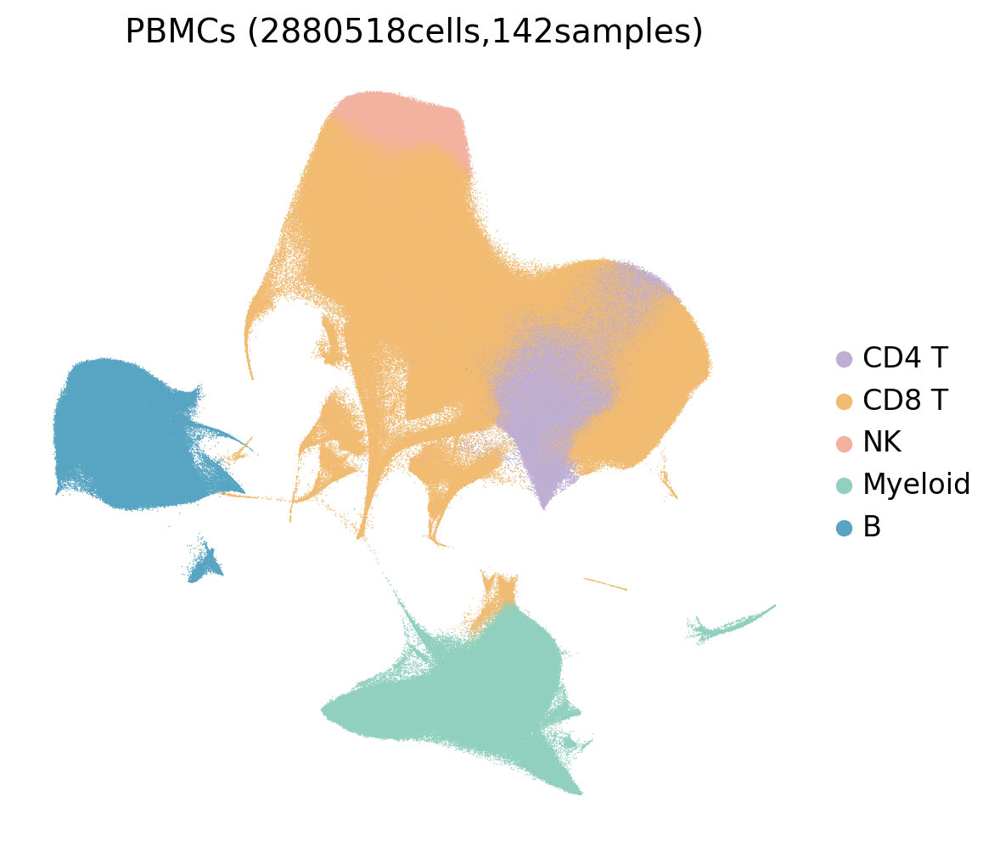

In [23]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata,color=['phase_ordered'],legend_fontsize=12,size=1,legend_fontoutline=2,
               palette=cluster_cols,title='PBMCs (2880518cells,142samples)',#legend_loc="on data",
               save='_celltype_L1_leiden_2.0_n2.pdf')

In [30]:
marker_genes_dict = {
    'T-cell': ['CD3D','CD4','CD8A','CD8B'],
    'NK-cell': ['IL7R','KLRC1','NCR1'],
    'Myeloid-cell': ['AIF1','LST1'],
    'B-cell': ['CD79A',"CD19"]
}

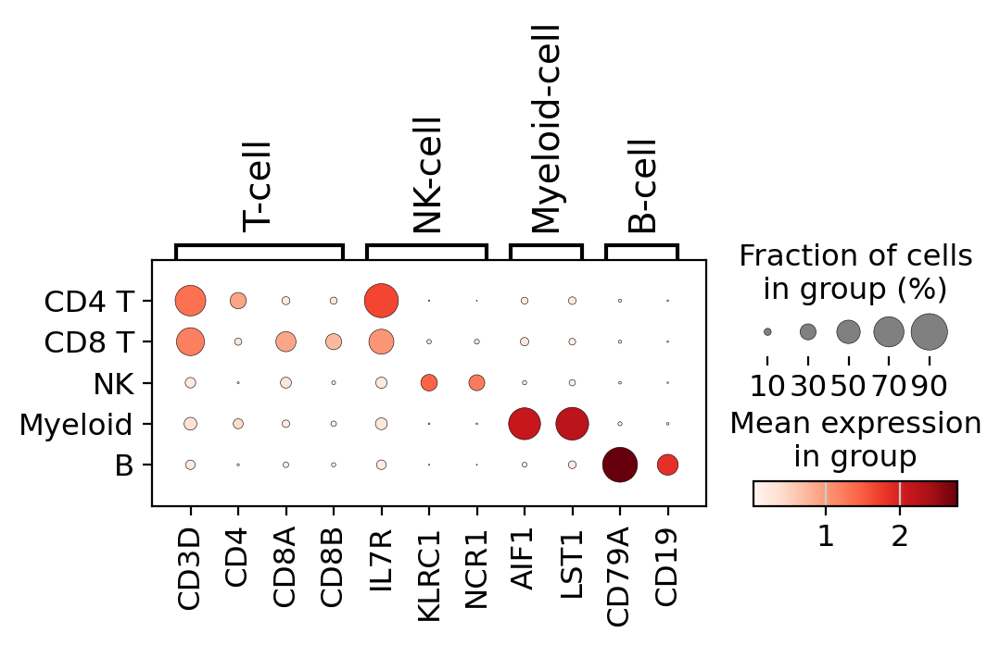

In [31]:
with rc_context({'figure.figsize': (10, 6)}):
    sc.pl.dotplot(adata, marker_genes_dict, groupby="celltype_L1",
                  categories_order=["CD4 T","CD8 T","NK","Myeloid","B"],save='_all_celltype_L1.pdf')

In [32]:
adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/pbmc_raw.h5ad')

### 亚群分群

In [14]:
adata.obs["celltype_L1"].value_counts()

CD8 T      1717643
CD4 T       381096
Myeloid     370555
B           295922
NK          115302
Name: celltype_L1, dtype: int64

In [16]:
B_adata=adata[adata.obs['celltype_L1'].isin(["B"])]
B_adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/B_raw.h5ad')
B_adata

View of AnnData object with n_obs × n_vars = 295922 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'sample_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'conne

In [19]:
Myeloid_adata=adata[adata.obs['celltype_L1'].isin(["Myeloid"])]
Myeloid_adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_raw.h5ad')
Myeloid_adata

View of AnnData object with n_obs × n_vars = 370555 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'sample_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'conne

In [20]:
CD4_adata=adata[adata.obs['celltype_L1'].isin(["CD4 T"])]
CD4_adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD4_raw.h5ad')
CD4_adata

View of AnnData object with n_obs × n_vars = 381096 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'sample_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'conne

In [21]:
CD8_adata=adata[adata.obs['celltype_L1'].isin(["CD8 T"])]
CD8_adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD8_raw.h5ad')
CD8_adata

View of AnnData object with n_obs × n_vars = 1717643 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'sample_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'conn

In [22]:
NK_adata=adata[adata.obs['celltype_L1'].isin(["NK"])]
NK_adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/NK_raw.h5ad')
NK_adata

View of AnnData object with n_obs × n_vars = 115302 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'sample_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'conne

### CD4 T/CD8 T/NK亚群调整

#### CD4聚类

In [6]:
CD4_adata=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD4_filter.h5ad")
CD4_adata.X = CD4_adata.layers['counts'].copy()
CD4_adata

AnnData object with n_obs × n_vars = 645339 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

In [7]:
sc.pp.normalize_total(CD4_adata, target_sum=1e4)
sc.pp.log1p(CD4_adata)
sc.pp.highly_variable_genes(CD4_adata,batch_key="stage")
CD4_adata.var.highly_variable.value_counts()

normalizing counts per cell
    finished (0:01:07)
extracting highly variable genes
    finished (0:00:31)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


False    17824
True      3855
Name: highly_variable, dtype: int64

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:04:07)


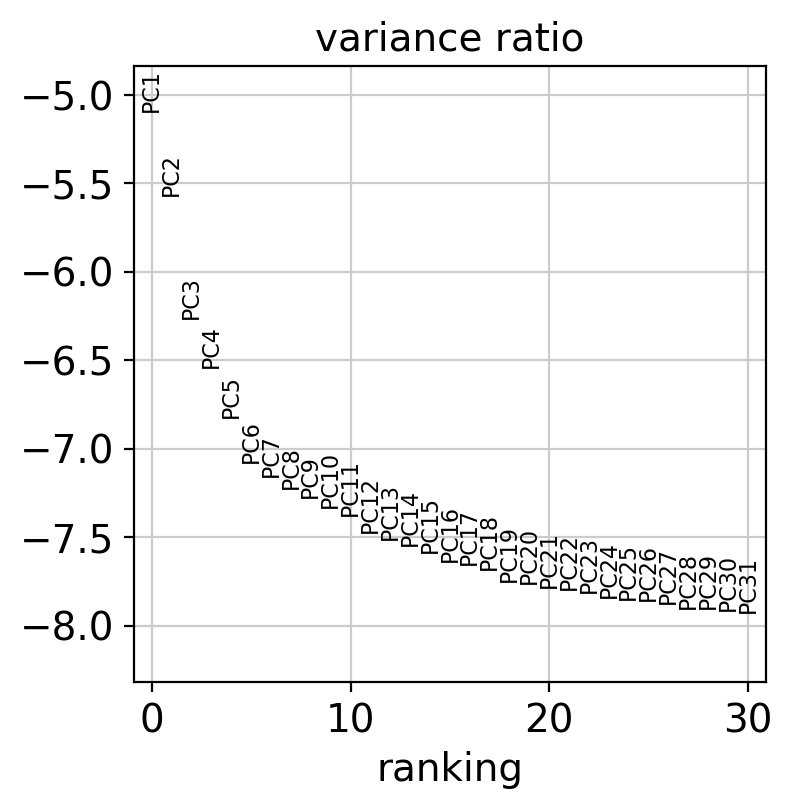

In [8]:
sc.pp.scale(CD4_adata, max_value=10)
sc.tl.pca(CD4_adata, svd_solver='arpack',n_comps=50,use_highly_variable=True)
sc.pl.pca_variance_ratio(CD4_adata,n_pcs=30,log=True)

In [9]:
rsc.pp.harmony_integrate(CD4_adata,key='experiments',max_iter_harmony = 30)

2024-05-11 09:42:00,693 - harmonypy_gpu - INFO - Iteration 1 of 30
2024-05-11 09:42:47,504 - harmonypy_gpu - INFO - Iteration 2 of 30
2024-05-11 09:43:34,351 - harmonypy_gpu - INFO - Iteration 3 of 30
2024-05-11 09:44:21,156 - harmonypy_gpu - INFO - Converged after 3 iterations


In [10]:
sc.pp.neighbors(CD4_adata, n_neighbors=30, n_pcs=13, use_rep='X_pca_harmony')
sc.tl.umap(CD4_adata,min_dist = 0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:02:56)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:17:50)


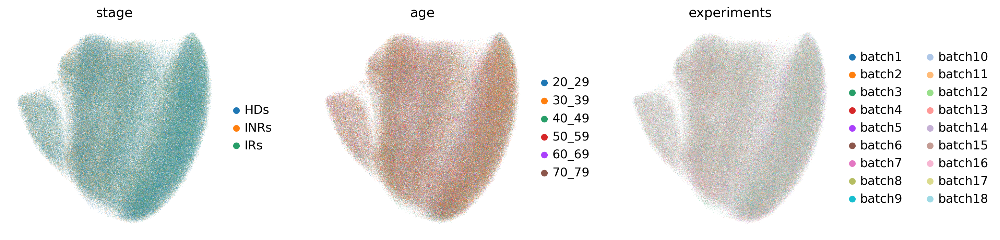

In [11]:
sc.pl.umap(CD4_adata, color=['stage', 'age', 'experiments'], wspace=0.3)

running Leiden clustering
    finished: found 54 clusters and added
    'leiden_r5.0_n2', the cluster labels (adata.obs, categorical) (0:04:06)


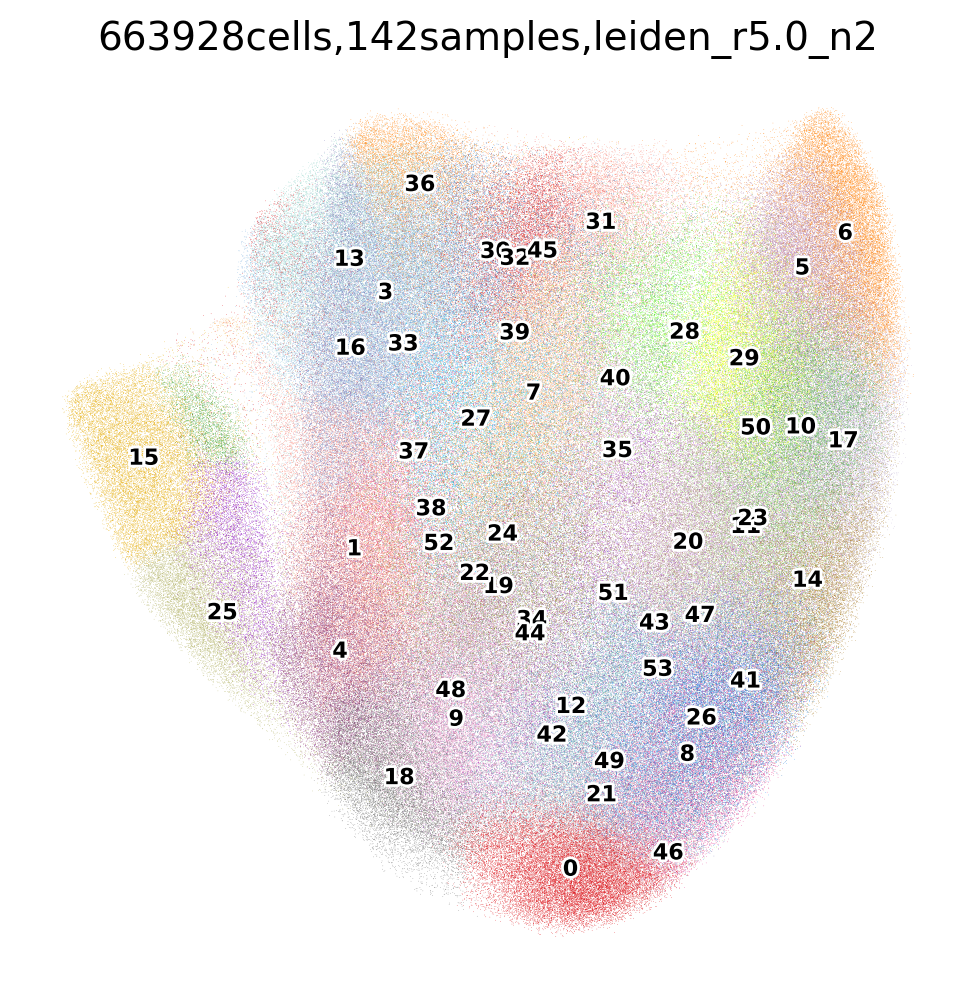

In [12]:
sc.tl.leiden(CD4_adata,resolution=5.0,n_iterations=2,key_added='leiden_r5.0_n2')
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(CD4_adata,color=['leiden_r5.0_n2'],legend_fontsize=8,legend_fontoutline=2,
               palette=cluster_cols,legend_loc="on data",title='663928cells,142samples,leiden_r5.0_n2')

In [ ]:
sc.pl.umap(CD4_adata, color=["CD3D","CD4","CD8A","CD8B"])

In [24]:
#去双胞
CD4_adata_sub = CD4_adata[~CD4_adata.obs['leiden_r5.0_n2'].isin(['20','30','35','39','48','52','53'])]
CD4_adata_sub

View of AnnData object with n_obs × n_vars = 698086 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [26]:
#CD4细胞
CD4_CD4 = CD4_adata_sub[~CD4_adata_sub.obs['leiden_r5.0_n2'].isin(['19','22','34','41','44'])]
CD4_CD4

View of AnnData object with n_obs × n_vars = 645339 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [27]:
#CD8细胞
CD4_CD8 = CD4_adata_sub[CD4_adata_sub.obs['leiden_r5.0_n2'].isin(['19','22','34','41','44'])]
CD4_CD8

View of AnnData object with n_obs × n_vars = 52747 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [28]:
del CD4_adata
del CD4_adata_sub

#### CD8聚类

In [5]:
CD8_adata=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD8_filter.h5ad")
CD8_adata.X = CD8_adata.layers['counts'].copy()
CD8_adata

AnnData object with n_obs × n_vars = 1287002 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

In [6]:
sc.pp.normalize_total(CD8_adata, target_sum=1e4)
sc.pp.log1p(CD8_adata)
sc.pp.highly_variable_genes(CD8_adata,batch_key="stage")
CD8_adata.var.highly_variable.value_counts()

normalizing counts per cell
    finished (0:02:11)
extracting highly variable genes
    finished (0:01:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


False    18485
True      3194
Name: highly_variable, dtype: int64

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:05:58)


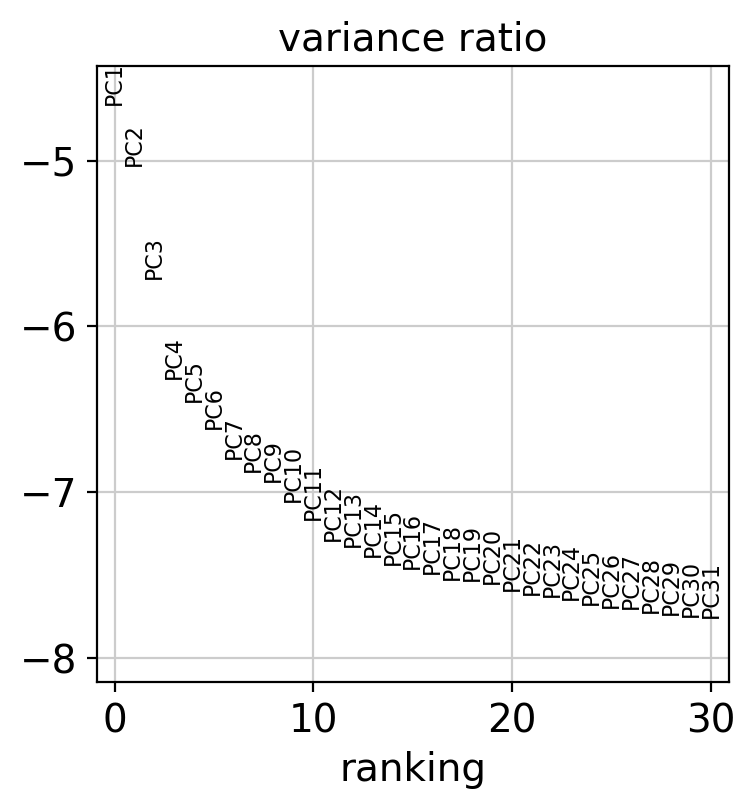

In [7]:
sc.pp.scale(CD8_adata, max_value=10)
sc.tl.pca(CD8_adata, svd_solver='arpack',n_comps=50,use_highly_variable=True)
sc.pl.pca_variance_ratio(CD8_adata,n_pcs=30,log=True)

In [8]:
rsc.pp.harmony_integrate(CD8_adata,key='experiments',max_iter_harmony = 30)

2024-05-11 10:39:30,515 - harmonypy_gpu - INFO - Iteration 1 of 30
2024-05-11 10:40:59,298 - harmonypy_gpu - INFO - Iteration 2 of 30
2024-05-11 10:42:28,078 - harmonypy_gpu - INFO - Iteration 3 of 30
2024-05-11 10:43:57,030 - harmonypy_gpu - INFO - Converged after 3 iterations


In [9]:
sc.pp.neighbors(CD8_adata, n_neighbors=30, n_pcs=13, use_rep='X_pca_harmony')
sc.tl.umap(CD8_adata,min_dist = 0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:05:41)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:44:01)


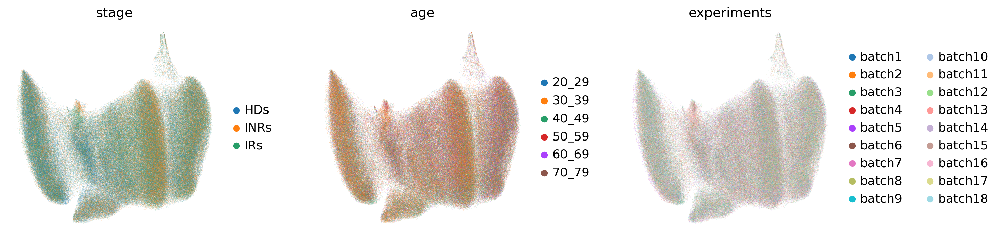

In [10]:
sc.pl.umap(CD8_adata, color=['stage', 'age', 'experiments'], wspace=0.3)

running Leiden clustering
    finished: found 59 clusters and added
    'leiden_r5.0_n2', the cluster labels (adata.obs, categorical) (0:08:42)


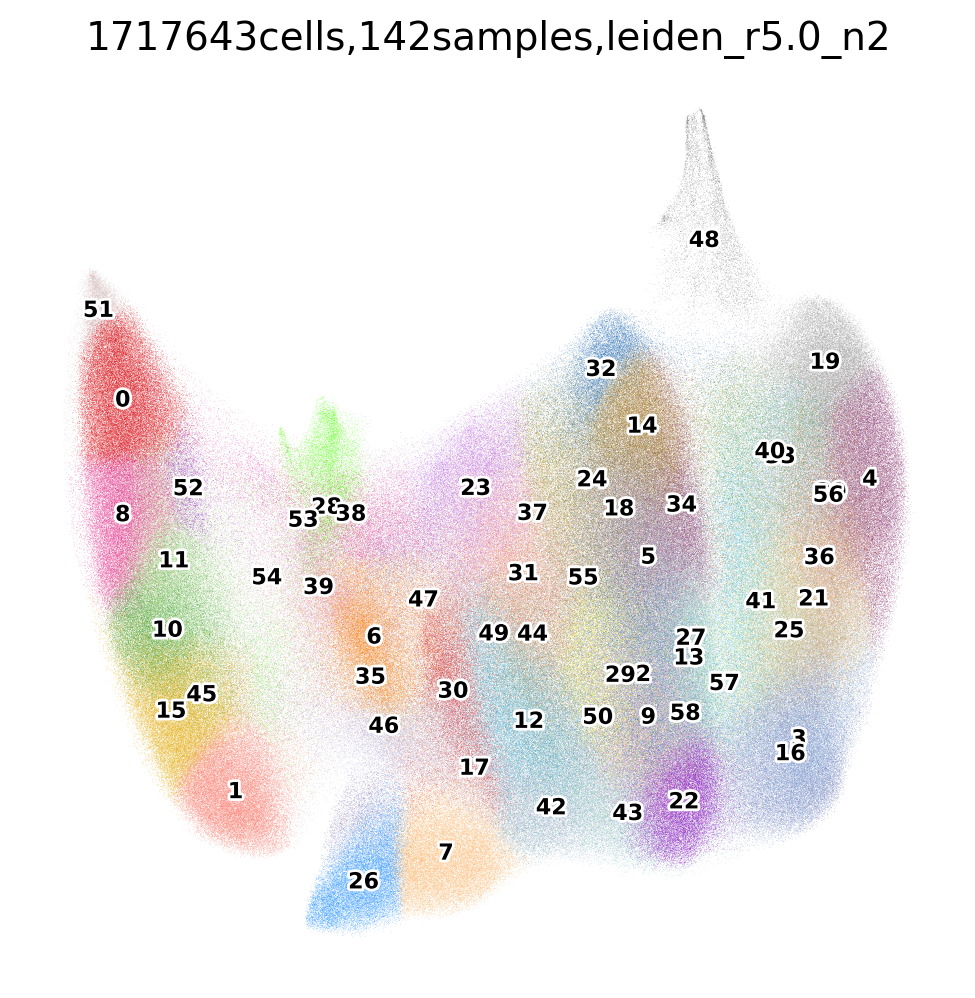

In [11]:
sc.tl.leiden(CD8_adata,resolution=5.0,n_iterations=2,key_added='leiden_r5.0_n2')
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(CD8_adata,color=['leiden_r5.0_n2'],legend_fontsize=8,legend_fontoutline=2,
               palette=cluster_cols,legend_loc="on data",title='1717643cells,142samples,leiden_r5.0_n2')

In [23]:
#去双胞
CD8_adata_sub = CD8_adata[~CD8_adata.obs['leiden_r5.0_n2'].isin(['28','56'])]
CD8_adata_sub

View of AnnData object with n_obs × n_vars = 1261644 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [18]:
#CD8细胞
CD8_CD8 = CD8_adata_sub[~CD8_adata_sub.obs['leiden_r5.0_n2'].isin([''])]
CD8_CD8

View of AnnData object with n_obs × n_vars = 1236645 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [46]:
#CD4细胞
CD8_CD4 = CD8_adata_sub[CD8_adata_sub.obs['leiden_r5.0_n2'].isin([''])]
CD8_CD4

View of AnnData object with n_obs × n_vars = 0 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [47]:
#NK细胞
CD8_NK = CD8_adata_sub[CD8_adata_sub.obs['leiden_r5.0_n2'].isin([''])]
CD8_NK

View of AnnData object with n_obs × n_vars = 0 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [26]:
CD8_adata_sub

View of AnnData object with n_obs × n_vars = 1261644 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [27]:
CD8_adata_sub.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD8_filter.h5ad')

In [48]:
del CD8_adata
del CD8_adata_sub

#### NK聚类

In [5]:
NK_adata=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/NK_filter.h5ad")
NK_adata.X = NK_adata.layers['counts'].copy()
NK_adata

AnnData object with n_obs × n_vars = 204859 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

In [6]:
sc.pp.normalize_total(NK_adata, target_sum=1e4)
sc.pp.log1p(NK_adata)
sc.pp.highly_variable_genes(NK_adata,batch_key="stage")
NK_adata.var.highly_variable.value_counts()

normalizing counts per cell
    finished (0:00:20)
extracting highly variable genes
    finished (0:00:10)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


False    17688
True      3991
Name: highly_variable, dtype: int64

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:01:52)


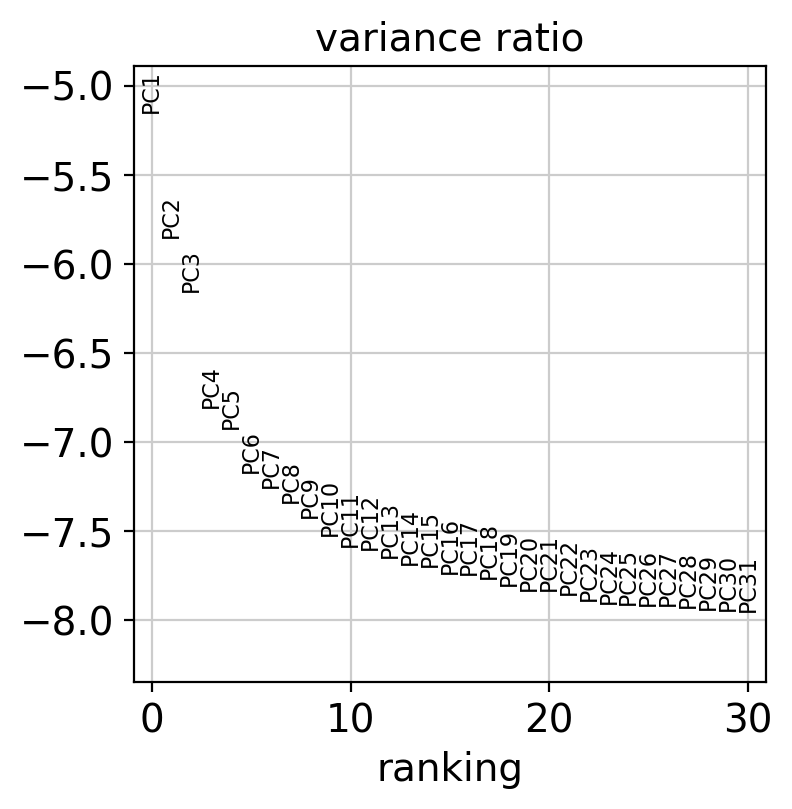

In [7]:
sc.pp.scale(NK_adata, max_value=10)
sc.tl.pca(NK_adata, svd_solver='arpack',n_comps=50,use_highly_variable=True)
sc.pl.pca_variance_ratio(NK_adata,n_pcs=30,log=True)

In [8]:
rsc.pp.harmony_integrate(NK_adata,key='experiments',max_iter_harmony = 30)

2024-05-11 15:01:41,833 - harmonypy_gpu - INFO - Iteration 1 of 30
2024-05-11 15:01:59,478 - harmonypy_gpu - INFO - Iteration 2 of 30
2024-05-11 15:02:16,543 - harmonypy_gpu - INFO - Converged after 2 iterations


In [9]:
sc.pp.neighbors(NK_adata, n_neighbors=30, n_pcs=13, use_rep='X_pca_harmony')
sc.tl.umap(NK_adata,min_dist = 0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:51)
computing UMAP


IOStream.flush timed out
IOStream.flush timed out


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:46)


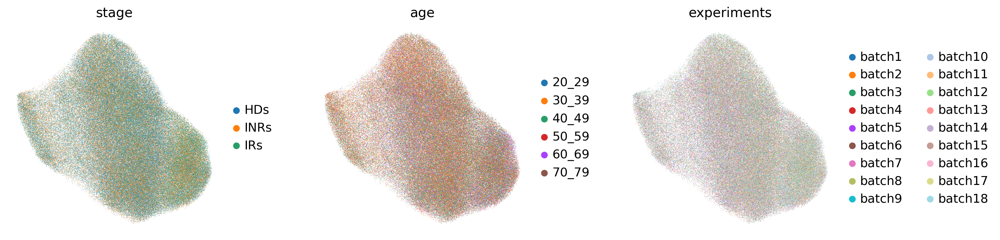

In [10]:
sc.pl.umap(NK_adata, color=["stage",'age',"experiments"],wspace=0.3)

running Leiden clustering
    finished: found 69 clusters and added
    'leiden_r5.0_n2', the cluster labels (adata.obs, categorical) (0:01:02)


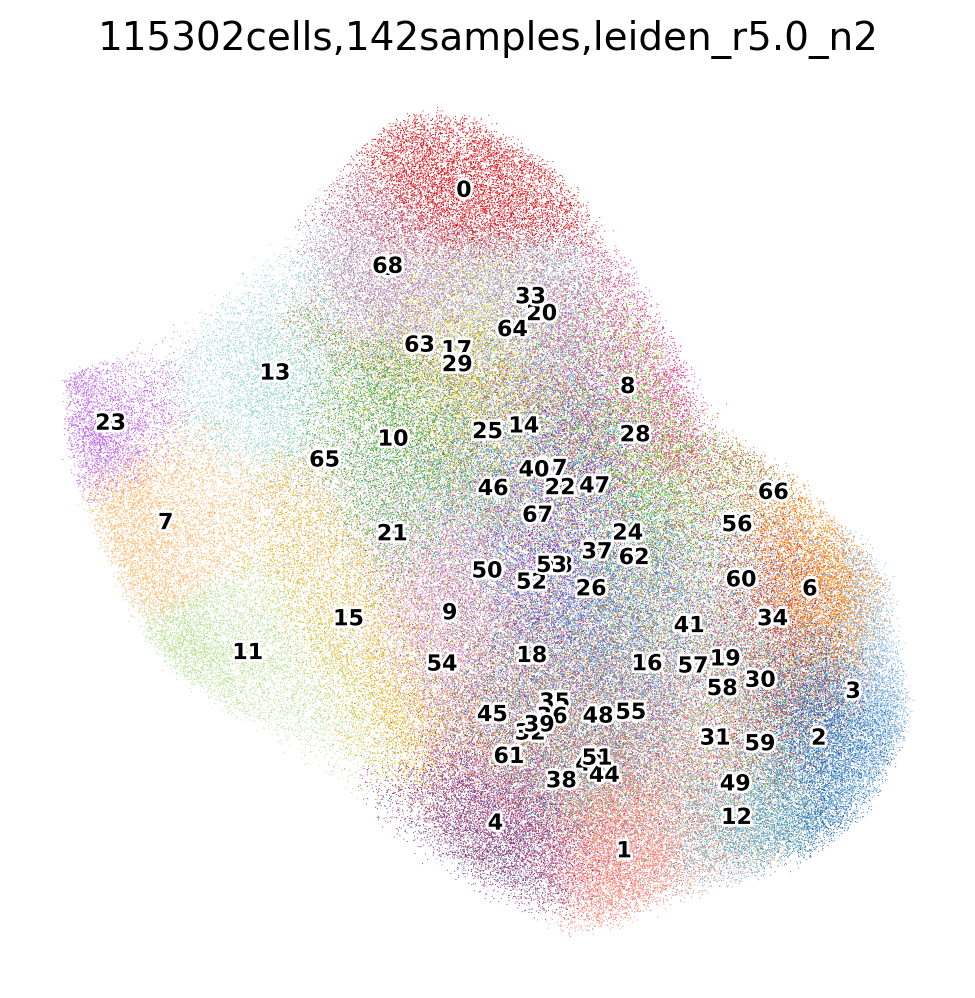

In [11]:
sc.tl.leiden(NK_adata,resolution=5.0,n_iterations=2,key_added='leiden_r5.0_n2')
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(NK_adata,color=['leiden_r5.0_n2'],legend_fontsize=8,legend_fontoutline=2,
               palette=cluster_cols,legend_loc="on data",title='115302cells,142samples,leiden_r5.0_n2')

In [66]:
#NK细胞
NK_NK = NK_adata[~NK_adata.obs['leiden_r5.0_n2'].isin(['3','4','6','9','12','29','33''43','44','53'])]
NK_NK

View of AnnData object with n_obs × n_vars = 204859 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [68]:
#CD8细胞
NK_CD8 = NK_adata[NK_adata.obs['leiden_r5.0_n2'].isin(['3','4','6','9','12','29','33''43','44','53'])]
NK_CD8

View of AnnData object with n_obs × n_vars = 44169 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'stage_colors', 'age_colors', 'experiments_colors', 'leiden', 'leiden_r5.0_n2_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [69]:
del NK_adata

#### CD4/CD8/NK细胞群调整

In [70]:
CD8_adata_new = sc.concat([CD8_CD8,CD4_CD8,NK_CD8])
CD8_adata_new

AnnData object with n_obs × n_vars = 1287002 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

In [71]:
CD4_adata_new = sc.concat([CD4_CD4,CD8_CD4])
CD4_adata_new

AnnData object with n_obs × n_vars = 645339 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

In [72]:
NK_adata_new = sc.concat([NK_NK,CD8_NK])
NK_adata_new

AnnData object with n_obs × n_vars = 204859 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

In [73]:
CD4_adata_new.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD4_filter.h5ad')
CD8_adata_new.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD8_filter.h5ad')
NK_adata_new.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/NK_filter.h5ad')

### 总聚类

#### 标签转移

In [ ]:
adata_B=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/B_celltype.h5ad")
adata_Myeloid=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_celltype.h5ad")
adata_CD4=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD4_celltype.h5ad")
adata_CD8=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/CD8_celltype.h5ad")
adata_NK=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/NK_celltype.h5ad")

In [6]:
adata=sc.concat([adata_B,adata_Myeloid,adata_CD4,adata_CD8,adata_NK])
adata.X = adata.layers['counts'].copy()
adata

AnnData object with n_obs × n_vars = 2744009 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'celltype_L1', 'phase_ordered', 'celltype_L3'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

In [ ]:
del adata_B
del adata_Myeloid
del adata_CD4
del adata_CD8
del adata_NK

In [21]:
new_cluster_names = ['CD8+ T & unconvensional T','CD8+ T & unconvensional T','CD8+ T & unconvensional T',
                     'CD4+ T','Myeloid','B','NK','CD8+ T & unconvensional T','CD8+ T & unconvensional T',
                     'CD8+ T & unconvensional T','CD8+ T & unconvensional T','CD4+ T','Myeloid','CD4+ T',
                     'CD4+ T','Myeloid','CD8+ T & unconvensional T','NK','CD4+ T','B','CD4+ T','CD4+ T','B',
                     'CD4+ T','CD4+ T','CD4+ T','CD4+ T','CD4+ T','CD4+ T','Myeloid','NK',
                     'CD8+ T & unconvensional T','B','CD8+ T & unconvensional T','B','CD4+ T','B','Myeloid',
                     'CD8+ T & unconvensional T','NK','B','B','CD8+ T & unconvensional T','Myeloid','Myeloid'
                     ,'Myeloid','B','CD8+ T & unconvensional T','CD8+ T & unconvensional T','Myeloid','B','B',
                     'B','B','Myeloid','Myeloid','B','NK']
adata.obs['celltype_L1']=adata.obs['celltype_L3'].replace(to_replace = adata.obs['celltype_L3'].value_counts().index.tolist(),
                                                         value = new_cluster_names)

In [22]:
new_cluster_names = ['CD8 CTL','NKT','CD8 Naive T','CD4 Naive T','Monocyte','Naive B','CD56dim NK',
                     'CD8 Memory T','CD8 Memory T','MAIT','CD8 CTL','CD4 Memory T','Monocyte','CD4 Memory T',
                     'CD4 Memory T','Monocyte','gdT','CD56dim NK','CD4 Naive T','Memory B','CD4 Helper T',
                     'CD4 Helper T','Memory B','CD4 Helper T','CD4 Memory T','CD4 Treg','CD4 Treg',
                     'CD4 Helper T','CD4 Helper T','cDC','CD56bright NK','CD8 Memory T','Memory B','gdT',
                     'Memory B','CD4 Memory T','Memory B','Monocyte','Cycling T','Transitional NK',
                     'Memory B','Memory B','gdT','pDC','Monocyte','Monocyte','Naive B','NKT','CD8 Memory T',
                     'Monocyte','Total Plasma','Memory B','Naive B','Total Plasma','cDC','pDC','Total Plasma',
                     'CD56dim NK']
adata.obs['celltype_L1_5']=adata.obs['celltype_L3'].replace(to_replace = adata.obs['celltype_L3'].value_counts().index.tolist(),
                                                         value = new_cluster_names)

In [23]:
new_cluster_names = ['CD8 CTL','NKT','CD8 Naive T','CD4 Naive T','cMono','Naive B','Mature NK','CD8 Tcm',
                     'CD8 Tem','MAIT','CD8 CTL','CD4 Tcm','ncMono','CD4 Tem','CD4 Tcm','cMono','gdT',
                     'Terminal NK','CD4 Naive T','Unswitched Memory B','CD4 Helper T','CD4 Helper T',
                     'Switched Memory B','CD4 Helper T','CD4 Tcm','CD4 Treg','CD4 Treg','CD4 Helper T',
                     'CD4 Helper T','cDC','CD56bright NK','CD8 Tcm','Transitional B','gdT','Switched Memory B',
                     'CD4 Tcm','Aptypical Memory B','ncMono','Cycling T','Transitional NK',
                     'Unswitched Memory B','Switched Memory B','gdT','pDC','ncMono','ncMono','Naive B','NKT',
                     'CD8 Tcm','cMono','Plasma B','Unswitched Memory B','Naive B','Plasma B','cDC','pDC',
                     'Plasmablast','Mature NK']
adata.obs['celltype_L2']=adata.obs['celltype_L3'].replace(to_replace = adata.obs['celltype_L3'].value_counts().index.tolist(),
                                                         value = new_cluster_names)

In [27]:
adata

AnnData object with n_obs × n_vars = 2744009 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'celltype_L1', 'phase_ordered', 'celltype_L3', 'celltype_L1_5', 'celltype_L2'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

#### 降维

In [5]:
adata=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/pbmc_celltype.h5ad")
adata.X = adata.layers['counts'].copy()
adata

AnnData object with n_obs × n_vars = 2744009 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'celltype_L1', 'phase_ordered', 'celltype_L3', 'celltype_L1_5', 'celltype_L2'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'counts'

In [6]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata,batch_key="stage")
adata.var.highly_variable.value_counts()

normalizing counts per cell
    finished (0:07:40)
extracting highly variable genes
    finished (0:03:13)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


False    18469
True      3210
Name: highly_variable, dtype: int64

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:13:38)


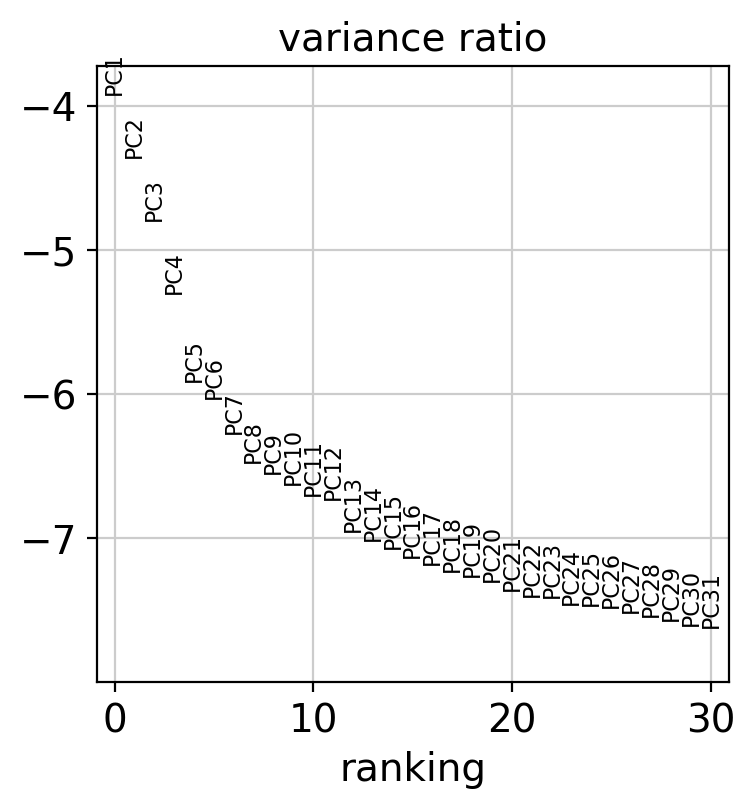

In [7]:
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack',n_comps=50,use_highly_variable=True)
sc.pl.pca_variance_ratio(adata,n_pcs=30,log=True)

In [8]:
rsc.pp.harmony_integrate(adata,key='batch',max_iter_harmony = 30)

2024-05-21 13:17:51,981 - harmonypy_gpu - INFO - Iteration 1 of 30
2024-05-21 13:31:34,560 - harmonypy_gpu - INFO - Iteration 2 of 30
2024-05-21 13:45:32,847 - harmonypy_gpu - INFO - Iteration 3 of 30
2024-05-21 13:59:31,619 - harmonypy_gpu - INFO - Iteration 4 of 30
2024-05-21 14:13:30,657 - harmonypy_gpu - INFO - Iteration 5 of 30
2024-05-21 14:26:09,623 - harmonypy_gpu - INFO - Converged after 5 iterations


In [9]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=31, use_rep='X_pca_harmony')
sc.tl.umap(adata,min_dist = 0.5)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:12:27)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (1:08:58)


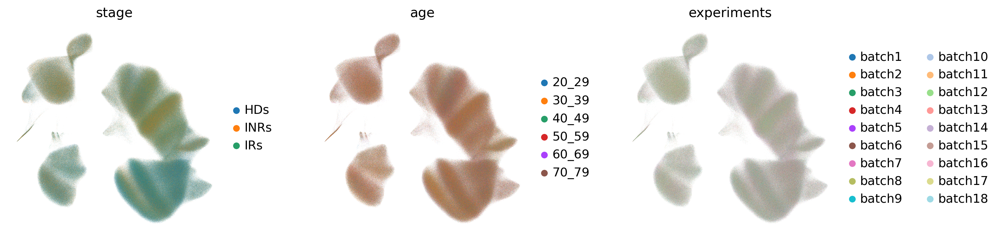

In [10]:
sc.pl.umap(adata, color=['stage', 'age', 'experiments'], wspace=0.3)

#### L1层级

In [11]:
phases = ['CD4+ T','CD8+ T & unconvensional T','NK','Myeloid','B']
adata.obs["phase_ordered"] = pd.Categorical(values=adata.obs.celltype_L1, categories=phases, ordered=True)

In [12]:
L1_colors={'CD4+ T':'#7C8CB2',
           'CD8+ T & unconvensional T':'#8799A4',
           'NK':'#A89FB7',
           'Myeloid':'#9BB496',
           'B':'#F9D3E3'
}

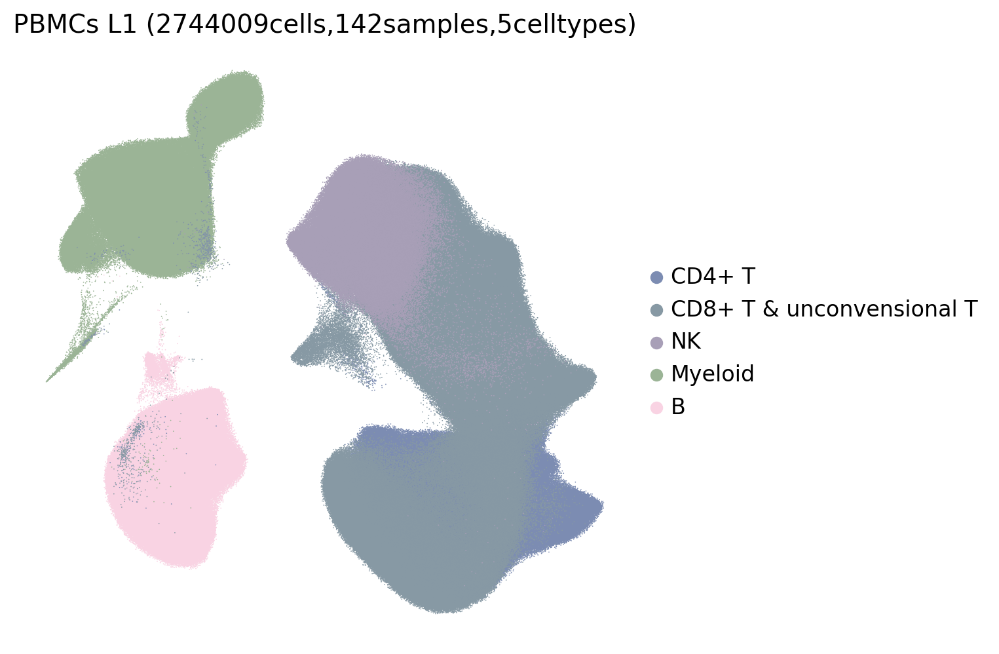

In [13]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata,color=['phase_ordered'],legend_fontsize=12,size=1.5,legend_fontoutline=2,
               palette=L1_colors,title='PBMCs L1 (2744009cells,142samples,5celltypes)',#legend_loc="on data",
               save='_ALL_celltype_L1.pdf')

#### L2层级

In [24]:
phases = ['CD4 Naive T','CD4 Tcm','CD4 Tem','CD4 Helper T','CD4 Treg','CD8 Naive T','CD8 Tcm','CD8 Tem',
          'CD8 CTL','MAIT','gdT','Cycling T','NKT','CD56bright NK','Transitional NK','Mature NK','Terminal NK',
          'cMono','ncMono','cDC','pDC','Naive B','Transitional B','Aptypical Memory B','Unswitched Memory B',
          'Switched Memory B','Plasma B','Plasmablast']
adata.obs["phase_ordered"] = pd.Categorical(values=adata.obs.celltype_L2, categories=phases, ordered=True)

In [25]:
L2_colors={'CD4 Naive T':'#A7B0C2',
             'CD4 Tcm':'#7F9DAD',
             'CD4 Tem':'#476485',
             'CD4 Helper T':'#557A90',
             'CD4 Treg':'#41578A',
             'CD8 Naive T':'#8799A4',
             'CD8 Tcm':'#C2CDCA',
             'CD8 Tem':'#667F85',
             'CD8 CTL':'#7E9594',
             'MAIT':'#89AEAE',
             'gdT':'#6F9FB7',
             'Cycling T':'#5F88A1',
             'NKT':'#717677',
             'CD56bright NK':'#5A7585',
             'Transitional NK':'#787CA5',
             'Mature NK':'#A89FB7',
             'Terminal NK':'#906A8C',
             'cMono':'#779649',
             'ncMono':'#AC9F8A',
             'cDC':'#BFC1A9',
             'pDC':'#8F6D5F',
             'Naive B':'#FFF799',
             'Transitional B':'#E0DE8A',
             'Aptypical Memory B':'#E67762',
             'Unswitched Memory B':'#B2778E',
             'Switched Memory B':'#D66047',
             'Plasma B':'#BA7AB1',
             'Plasmablast':'#8A1874'
}

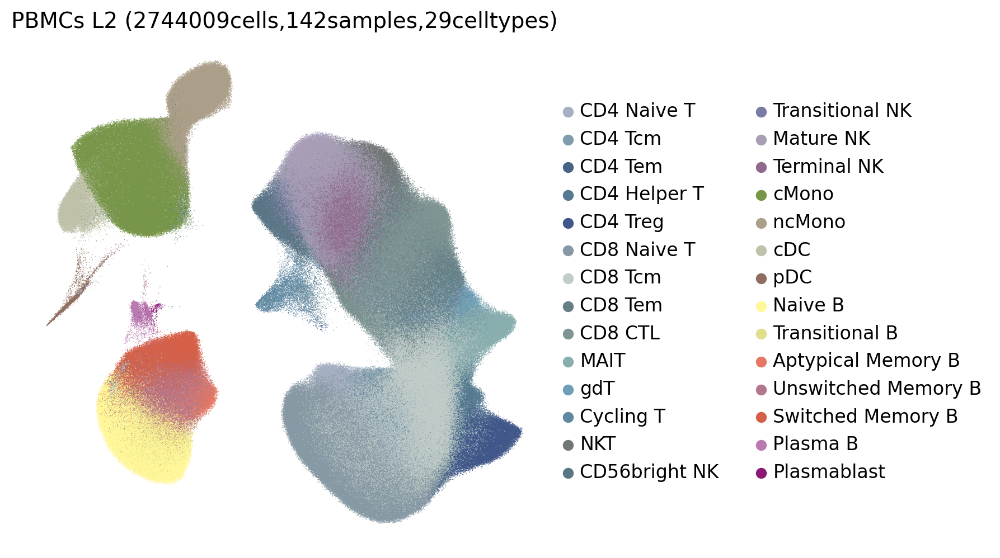

In [28]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata,color=['phase_ordered'],legend_fontsize=12,size=0.8,legend_fontoutline=2,
               palette=L2_colors,title='PBMCs L2 (2744009cells,142samples,28celltypes)',#legend_loc="on data",
               save='_ALL_celltype_L2.pdf')

#### L3层级

In [12]:
phases = ['CD4_Naive_T-CCR7','CD4_Naive_T-SOX4','CD4_Tcm-GPR183','CD4_Tcm-SOX4','CD4_Tcm-CXCR5','CD4_Tcm-IFIT3',
          'CD4_Tem-CCR7neg','CD4_Tfh_like-CXCR5','CD4_Th-TNFRSF11A','CD4_Th1-GZMK','CD4_Th17-RORC',
          'CD4_Th22-CCR10','CD4_Treg-FCRL3','CD4_Treg-FOXP3','CD8_Naive_T-CCR7','CD8_Tcm-GPR183','CD8_Tcm-IFI44L',
          'CD8_Tcm-GZMK','CD8_Tem-GZMK','CD8_CTL-GZMK','CD8_CTL-GZMB','MAIT-SLC4A10','gdT2-GZMK','gdT2-GZMH',
          'gdT2-IL12RB2','Cycling_T-MKI67','NKT-NCR1','NKT-IFIT3','NK_bright-XCL1','Transitional_NK-GZMK',
          'Mature_NK_dim-FCGR3A','Terminal_NK_dim-CD160neg','Inflamed_NK_dim-IFI44L','cMono-CD14','cMono-IFI44L',
          'cMono-IL1B','ncMono-FCGR3A','ncMono-IFI44L','ncMono-IFIT1','ncMono-C1QA','cDC1-BATF3','cDC2-CD1C',
          'pDC-LILRA4','pDC-AXL','Naive_B-TCL1A','Naive_B-IL6','Naive_B-IFIT3','Transitional_B-NEIL1',
          'Aptypical_Memory_B-ITGAX','Unswitched_Memory_B-CD1C','Unswitched_Memory_B-IFIT3',
          'Unswitched_Memory_B-JAM3','Switched_Memory_B-CD27','Switched_Memory_B-CD86','Switched_Memory_B-IGHE',
          'Plasma_B-IGHA1','Plasma_B-IGHG1','Plasmablast-MKI67']
adata.obs["phase_ordered"] = pd.Categorical(values=adata.obs.celltype_L3, categories=phases, ordered=True)

In [13]:
L3_colors={'CD4_Naive_T-CCR7':'#A7B0C2',
           'CD4_Naive_T-SOX4':'#8D9FB8',
           'CD4_Tcm-GPR183':'#7F9DAD',
           'CD4_Tcm-SOX4':'#AEC2D7',
           'CD4_Tcm-CXCR5':'#7C8CB2',
           'CD4_Tcm-IFIT3':'#3E436D',
           'CD4_Tem-CCR7neg':'#476485',
           'CD4_Tfh_like-CXCR5':'#557A90',
           'CD4_Th-TNFRSF11A':'#383857',
           'CD4_Th1-GZMK':'#4C5CB0',
           'CD4_Th17-RORC':'#557396',
           'CD4_Th22-CCR10':'#B3C5C8',
           'CD4_Treg-FOXP3':'#41578A',
           'CD4_Treg-FCRL3':'#7A8EA7',
           'CD8_Naive_T-CCR7':'#8799A4',
           'CD8_Tcm-GPR183':'#C2CDCA',
           'CD8_Tcm-IFI44L':'#3E4952',
           'CD8_Tcm-GZMK':'#7C9999',
           'CD8_Tem-GZMK':'#667F85',
           'CD8_CTL-GZMK':'#A0AEB0',
           'CD8_CTL-GZMB':'#7E9594',
           'MAIT-SLC4A10':'#89AEAE',
           'gdT2-GZMK':'#6F9FB7',
           'gdT2-GZMH':'#90B0B2',
           'gdT2-IL12RB2':'#708C9B',
           'Cycling_T-MKI67':'#5F88A1',
           'NKT-NCR1':'#6C9FA9',
           'NKT-IFIT3':'#717677',
           'NK_bright-XCL1':'#5A7585',
           'Transitional_NK-GZMK':'#787CA5',
           'Mature_NK_dim-FCGR3A':'#A89FB7',
           'Terminal_NK_dim-CD160neg':'#906A8C',
           'Inflamed_NK_dim-IFI44L':'#3C314B',
           'cMono-CD14':'#779649',
           'cMono-IFI44L':'#C0D09D',
           'cMono-IL1B':'#13393E',
           'ncMono-FCGR3A':'#AC9F8A',
           'ncMono-IFI44L':'#D5C8A0',
           'ncMono-IFIT1':'#68361A',
           'ncMono-C1QA':'#79836C',
           'cDC1-BATF3':'#BFC1A9',
           'cDC2-CD1C':'#9BB496',
           'pDC-LILRA4':'#E0E0D0',
           'pDC-AXL':'#8F6D5F',
           'Naive_B-TCL1A':'#FFF799',
           'Naive_B-IL6':'#D6BC46',
           'Naive_B-IFIT3':'#AB9556',
           'Transitional_B-NEIL1':'#E0DE8A',
           'Aptypical_Memory_B-ITGAX':'#E67762',
           'Unswitched_Memory_B-CD1C':'#B2778E',
           'Unswitched_Memory_B-IFIT3':'#C3555E',
           'Unswitched_Memory_B-JAM3':'#F9D3E3',
           'Switched_Memory_B-CD27':'#D39EB1',
           'Switched_Memory_B-CD86':'#D66047',
           'Switched_Memory_B-IGHE':'#A04236',
           'Plasma_B-IGHA1':'#BA7AB1',
           'Plasma_B-IGHG1':'#7D5284',
           'Plasmablast-MKI67':'#8A1874'
}

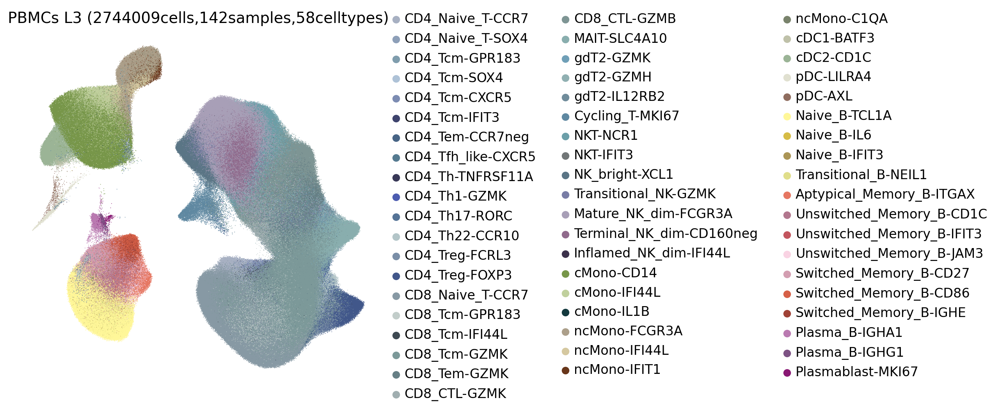

In [22]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata,color=['phase_ordered'],legend_fontsize=12,size=0.8,legend_fontoutline=2,
               palette=L3_colors,title='PBMCs L3 (2744009cells,142samples,58celltypes)',#legend_loc="on data",
               save='_ALL_celltype_L3.pdf')

In [4]:
adata=sc.read("/media/AnalysisDisk2/Yangshichen/0_HIV_RNA/HIV-pbmc/pbmc_celltype.h5ad")
adata

AnnData object with n_obs × n_vars = 2744009 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'celltype_L1', 'phase_ordered', 'celltype_L3', 'celltype_L1_5', 'celltype_L2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'age_colors', 'celltype_L2_colors', 'experiments_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [24]:
import pandas as pd

# 计算每个 celltype_L3 的细胞数量
cell_counts = adata.obs['celltype_L3'].value_counts()

# 将结果转换为 DataFrame
cell_counts_df = cell_counts.reset_index()
cell_counts_df.columns = ['CellType_L3', 'Cell_Count']  # 重命名列

# 保存到 CSV 文件
cell_counts_df.to_csv('celltype_L3_counts.csv', index=False)

In [7]:
phases = ['HDs','IRs','INRs']
adata.obs["phase_ordered"] = pd.Categorical(values=adata.obs.stage, categories=phases, ordered=True)

In [8]:
L3_colors={'HDs':'#3A6FB0',
           'IRs':'#F2B276',
           'INRs':'#BB2F29'
}

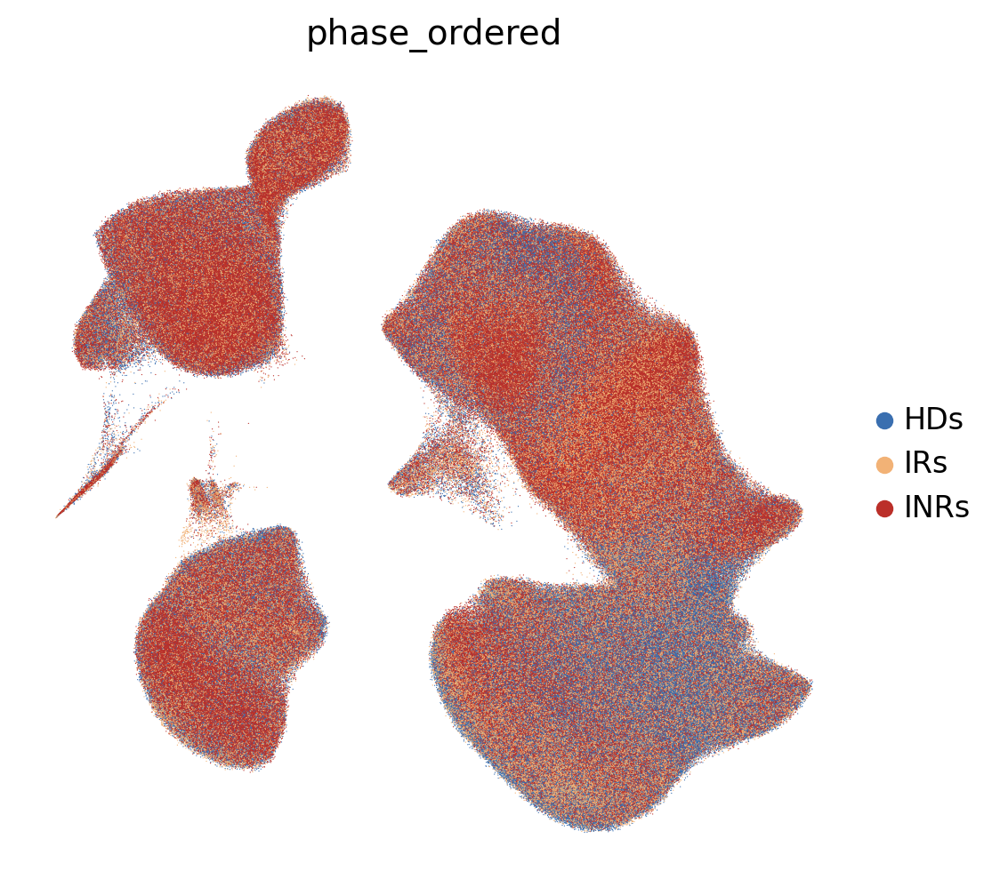

In [13]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata,color=['phase_ordered'],legend_fontsize=12,size=0.8,legend_fontoutline=2,
               save='_ALL_sample.pdf')

### 细胞比例

In [28]:
# 计算每个样本中每种细胞类型的计数
cell_counts = adata.obs.groupby(['sample', 'celltype_L1']).size().reset_index(name='count')
# 计算每个样本中细胞类型的总计数
sample_totals = cell_counts.groupby('sample')['count'].sum().reset_index(name='total_count')
# 合并计数和总计数数据框
merged_data = pd.merge(cell_counts, sample_totals, on='sample')
# 计算每个样本中细胞类型的比例
merged_data['proportion'] = merged_data['count'] / merged_data['total_count']
# 输出结果
print(merged_data)
merged_data.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/proportions_L1.csv', index=False)

      sample                celltype_L1  count  total_count  proportion
0    HD-H134                     CD4+ T  15620        46020    0.339418
1    HD-H134  CD8+ T & unconvensional T  18840        46020    0.409387
2    HD-H134                         NK   2658        46020    0.057757
3    HD-H134                          B   3609        46020    0.078422
4    HD-H134                    Myeloid   5293        46020    0.115015
..       ...                        ...    ...          ...         ...
705  PD-H308                     CD4+ T   3079        10767    0.285966
706  PD-H308  CD8+ T & unconvensional T   4562        10767    0.423702
707  PD-H308                         NK    499        10767    0.046345
708  PD-H308                          B   1466        10767    0.136157
709  PD-H308                    Myeloid   1161        10767    0.107829

[710 rows x 5 columns]


In [29]:
# 计算每个样本中每种细胞类型的计数
cell_counts = adata.obs.groupby(['sample', 'celltype_L1_5']).size().reset_index(name='count')
# 计算每个样本中细胞类型的总计数
sample_totals = cell_counts.groupby('sample')['count'].sum().reset_index(name='total_count')
# 合并计数和总计数数据框
merged_data = pd.merge(cell_counts, sample_totals, on='sample')
# 计算每个样本中细胞类型的比例
merged_data['proportion'] = merged_data['count'] / merged_data['total_count']
# 输出结果
print(merged_data)
merged_data.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/proportions_L1.5.csv', index=False)

       sample celltype_L1_5  count  total_count  proportion
0     HD-H134   CD4 Naive T   7634        46020    0.165884
1     HD-H134  CD4 Memory T   3917        46020    0.085115
2     HD-H134  CD4 Helper T   2919        46020    0.063429
3     HD-H134      CD4 Treg   1150        46020    0.024989
4     HD-H134       CD8 CTL   5383        46020    0.116971
...       ...           ...    ...          ...         ...
2835  PD-H308      Memory B    647        10767    0.060091
2836  PD-H308           cDC     25        10767    0.002322
2837  PD-H308      Monocyte   1064        10767    0.098820
2838  PD-H308           gdT    101        10767    0.009381
2839  PD-H308           pDC     72        10767    0.006687

[2840 rows x 5 columns]


In [30]:
# 计算每个样本中每种细胞类型的计数
cell_counts = adata.obs.groupby(['sample', 'celltype_L2']).size().reset_index(name='count')
# 计算每个样本中细胞类型的总计数
sample_totals = cell_counts.groupby('sample')['count'].sum().reset_index(name='total_count')
# 合并计数和总计数数据框
merged_data = pd.merge(cell_counts, sample_totals, on='sample')
# 计算每个样本中细胞类型的比例
merged_data['proportion'] = merged_data['count'] / merged_data['total_count']
# 输出结果
print(merged_data)
merged_data.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/proportions_L2.csv', index=False)

       sample         celltype_L2  count  total_count  proportion
0     HD-H134  Aptypical Memory B     76        46020    0.001651
1     HD-H134         CD4 Naive T   7634        46020    0.165884
2     HD-H134             CD4 Tcm   2340        46020    0.050847
3     HD-H134             CD4 Tem   1577        46020    0.034268
4     HD-H134        CD4 Helper T   2919        46020    0.063429
...       ...                 ...    ...          ...         ...
3971  PD-H308                 cDC     25        10767    0.002322
3972  PD-H308               cMono    613        10767    0.056933
3973  PD-H308                 gdT    101        10767    0.009381
3974  PD-H308              ncMono    451        10767    0.041887
3975  PD-H308                 pDC     72        10767    0.006687

[3976 rows x 5 columns]


In [31]:
# 计算每个样本中每种细胞类型的计数
cell_counts = adata.obs.groupby(['sample', 'celltype_L3']).size().reset_index(name='count')
# 计算每个样本中细胞类型的总计数
sample_totals = cell_counts.groupby('sample')['count'].sum().reset_index(name='total_count')
# 合并计数和总计数数据框
merged_data = pd.merge(cell_counts, sample_totals, on='sample')
# 计算每个样本中细胞类型的比例
merged_data['proportion'] = merged_data['count'] / merged_data['total_count']
# 输出结果
print(merged_data)
merged_data.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/proportions_L3.csv', index=False)

       sample               celltype_L3  count  total_count  proportion
0     HD-H134  Aptypical_Memory_B-ITGAX     76        46020    0.001651
1     HD-H134          CD4_Naive_T-CCR7   7030        46020    0.152760
2     HD-H134          CD4_Naive_T-SOX4    604        46020    0.013125
3     HD-H134             CD4_Tcm-CXCR5   1071        46020    0.023272
4     HD-H134            CD4_Tcm-GPR183    719        46020    0.015624
...       ...                       ...    ...          ...         ...
8231  PD-H308             ncMono-FCGR3A    260        10767    0.024148
8232  PD-H308             ncMono-IFI44L    110        10767    0.010216
8233  PD-H308              ncMono-IFIT1     30        10767    0.002786
8234  PD-H308                   pDC-AXL      1        10767    0.000093
8235  PD-H308                pDC-LILRA4     71        10767    0.006594

[8236 rows x 5 columns]


### DEG

In [4]:
adata=sc.read("/media/AnalysisDisk2/Yangshichen/0_HIV_RNA/HIV-pbmc/pbmc_celltype.h5ad")
adata

AnnData object with n_obs × n_vars = 2744009 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'celltype_L1', 'phase_ordered', 'celltype_L3', 'celltype_L1_5', 'celltype_L2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'age_colors', 'celltype_L2_colors', 'experiments_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [6]:
# 1. 创建一个包含每个分组中10%细胞的索引
sampled_indices = []

# 对每个分组进行操作
for stage in adata.obs['stage'].unique():
    # 获取当前分组的所有细胞索引
    group_cells = adata.obs[adata.obs['stage'] == stage].index
    # 从中随机抽取10%的细胞
    sampled_cells = group_cells.to_list()
    n_samples = int(len(sampled_cells) * 0.1)  # 计算10%的样本数
    sampled_cells = pd.Series(sampled_cells).sample(n=n_samples, random_state=42).to_list()  # 随机抽样
    sampled_indices.extend(sampled_cells)

# 2. 创建一个新的 AnnData 对象，只包含抽取的细胞
adata_sampled = adata[sampled_indices, :]
adata_sampled

View of AnnData object with n_obs × n_vars = 274400 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'celltype_L1', 'phase_ordered', 'celltype_L3', 'celltype_L1_5', 'celltype_L2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'age_colors', 'celltype_L2_colors', 'experiments_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [7]:
adata_sampled.write_h5ad("/media/AnalysisDisk2/Yangshichen/0_HIV_RNA/HIV-pbmc/pbmc_celltype_27w.h5ad")

In [8]:
del adata
del adata_sampled

In [9]:
adata=sc.read("/media/AnalysisDisk2/Yangshichen/0_HIV_RNA/HIV-pbmc/pbmc_celltype_27w.h5ad")
adata

AnnData object with n_obs × n_vars = 274400 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'celltype_L1', 'phase_ordered', 'celltype_L3', 'celltype_L1_5', 'celltype_L2'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'age_colors', 'celltype_L2_colors', 'experiments_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [10]:
adata.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata, groupby='stage',groups=['IRs','INRs'],reference='HDs',method='wilcoxon', key_added = "wilcoxon_HDs")
sc.tl.rank_genes_groups(adata, groupby='stage',groups=['INRs'],reference='IRs',method='wilcoxon', key_added = "wilcoxon_IRs")
genes1 = sc.get.rank_genes_groups_df(adata, group='IRs', key='wilcoxon_HDs')
genes2 = sc.get.rank_genes_groups_df(adata, group='INRs', key='wilcoxon_HDs')
genes3 = sc.get.rank_genes_groups_df(adata, group='INRs', key='wilcoxon_IRs')
genes1.to_csv('/media/AnalysisDisk2/Yangshichen/0_HIV_RNA/DEG/0_PBMCs_IRs_vs_HDs.csv', index=False)
genes2.to_csv('/media/AnalysisDisk2/Yangshichen/0_HIV_RNA/DEG/0_PBMCs_INRs_vs_HDs.csv', index=False)
genes3.to_csv('/media/AnalysisDisk2/Yangshichen/0_HIV_RNA/DEG/0_PBMCs_INRs_vs_IRs.csv', index=False)

ranking genes
    finished: added to `.uns['wilcoxon_HDs']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:29:43)
ranking genes
    finished: added to `.uns['wilcoxon_IRs']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:13:11)


In [6]:
unique_celltypes = adata.obs['celltype_L2'].unique()
unique_celltypes

['Switched Memory B', 'Unswitched Memory B', 'Naive B', 'Aptypical Memory B', 'Transitional B', ..., 'Cycling T', 'CD56bright NK', 'Mature NK', 'Terminal NK', 'Transitional NK']
Length: 28
Categories (28, object): ['Aptypical Memory B', 'CD4 Naive T', 'CD4 Tcm', 'CD4 Tem', ..., 'cMono', 'gdT', 'ncMono', 'pDC']

In [7]:
for celltype in unique_celltypes:
    celltype_data = adata[adata.obs['celltype_L2'] == celltype, :]
    celltype_data.uns['log1p']['base']=None
    sc.tl.rank_genes_groups(celltype_data, groupby='stage',groups=['IRs','INRs'],reference='HDs',method='wilcoxon', key_added = "wilcoxon_HDs")
    sc.tl.rank_genes_groups(celltype_data, groupby='stage',groups=['INRs'],reference='IRs',method='wilcoxon', key_added = "wilcoxon_IRs")
    genes1 = sc.get.rank_genes_groups_df(celltype_data, group='IRs', key='wilcoxon_HDs')
    genes2 = sc.get.rank_genes_groups_df(celltype_data, group='INRs', key='wilcoxon_HDs')
    genes3 = sc.get.rank_genes_groups_df(celltype_data, group='INRs', key='wilcoxon_IRs')
    genes1.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/DEG/{}_IRs_vs_HDs.csv'.format(celltype), index=False)
    genes2.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/DEG/{}_INRs_vs_HDs.csv'.format(celltype), index=False)
    genes3.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/DEG/{}_INRs_vs_IRs.csv'.format(celltype), index=False)

ranking genes
    finished: added to `.uns['wilcoxon_HDs']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:03:35)
ranking genes
    finished: added to `.uns['wilcoxon_IRs']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:03)
ranking genes
    finished: added to `.uns['wilcoxon_HDs']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group